In [3]:
# #importing some useful packages
import os
import sys
# sys.path.append('/home/seunghwan/anaconda3/lib/python3.6/site-packages/cv2.so')
cv2_path = '/home/seunghwan/anaconda3/envs/common/lib/python3.6/site-packages/cv2.cpython-36m-x86_64-linux-gnu.so'
sys.path.append(cv2_path)
ros_path = '/opt/ros/kinetic/lib/python2.7/dist-packages'
if ros_path in sys.path:
    sys.path.remove(ros_path)
import os
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import numpy as np
import random
import glob

import cv2
from pyspark import SparkConf, SparkContext

sys.path.append('/opt/ros/kinetic/lib/python2.7/dist-packages')
# %matplotlib inline

(720, 1280, 3)


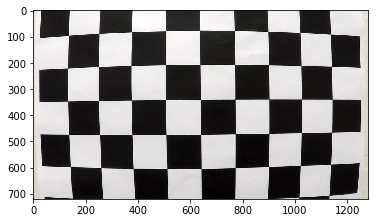

In [5]:
img = mpimg.imread('./camera_cal/calibration1.jpg')
image_shape = img.shape
print(image_shape)
plt.imshow(img)

In [44]:
def cal_undistort(img, objpoints, imgpoints, mtx, dist):
    # Use cv2.calibrateCamera() and cv2.undistort()
#     ret, mtx, dist, rvecs, tvecs = cv2.calibrateCamera(objpoints,imgpoints, img.shape[1:],None,None)
    undist = cv2.undistort(img,mtx,dist,None,mtx)
    
    return undist

In [45]:
path = os.listdir('./camera_cal')

nx = 9
ny = 6

object_point = []
image_point = []

obj_point = np.zeros((nx*ny, 3), np.float32)
obj_point[:,:2] = np.mgrid[0:nx, 0:ny].T.reshape(-1,2)

fnames = glob.glob("./camera_cal/calibration*.jpg")

for fname in fnames:
    img = mpimg.imread(fname)
    gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    ret, corners = cv2.findChessboardCorners(gray, (nx, ny), None)
    
    if ret:
        object_point.append(obj_point)
        image_point.append(corners)

ret, mtx, dist, rvecs, tvecs = cv2.calibrateCamera(object_point, image_point, img.shape[1:],None,None)

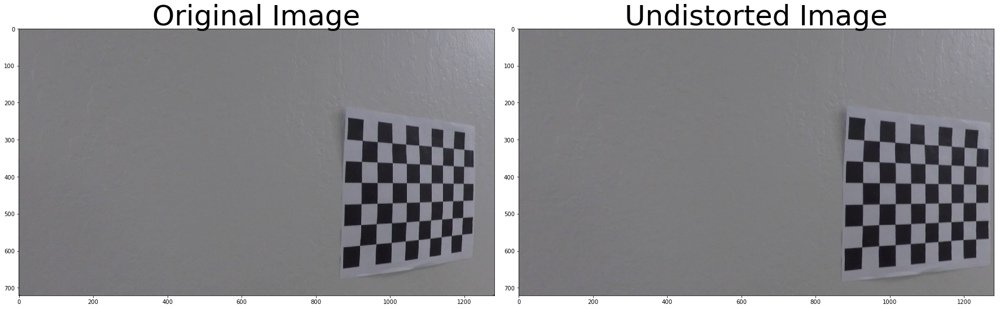

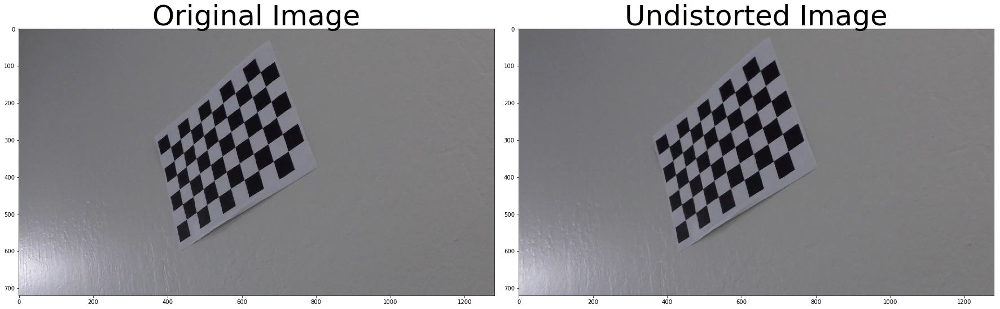

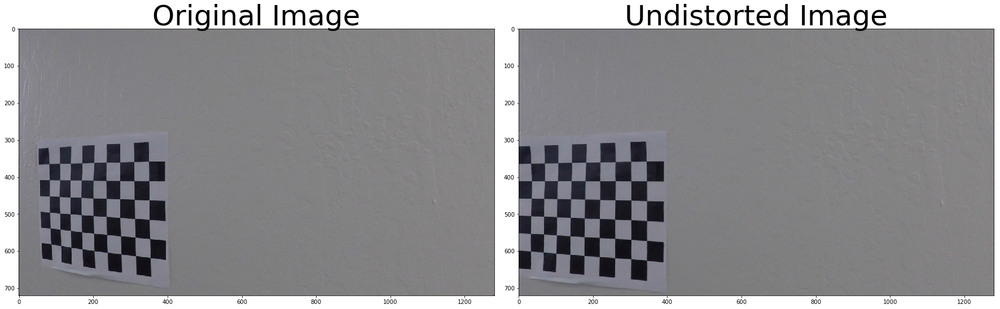

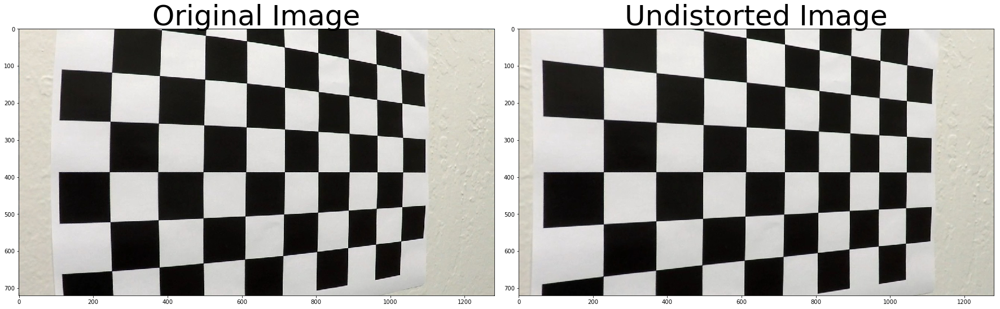

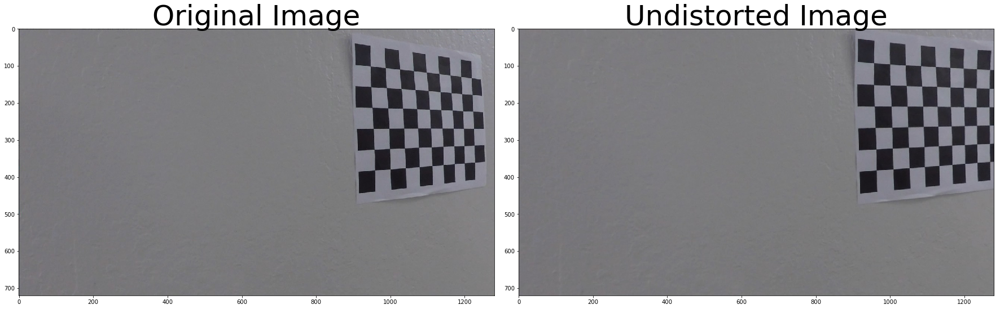

...

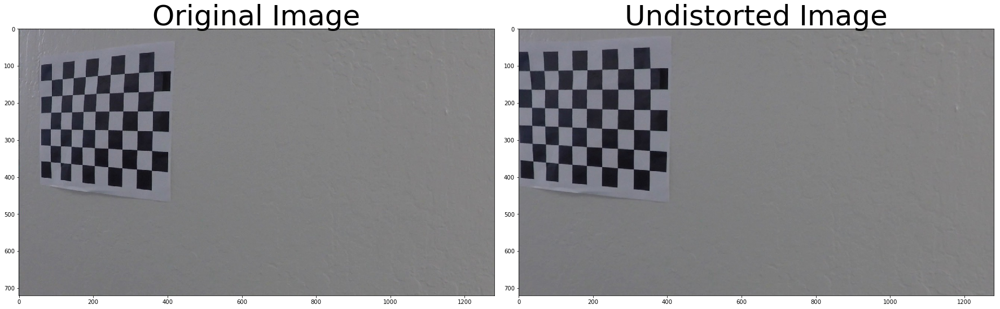

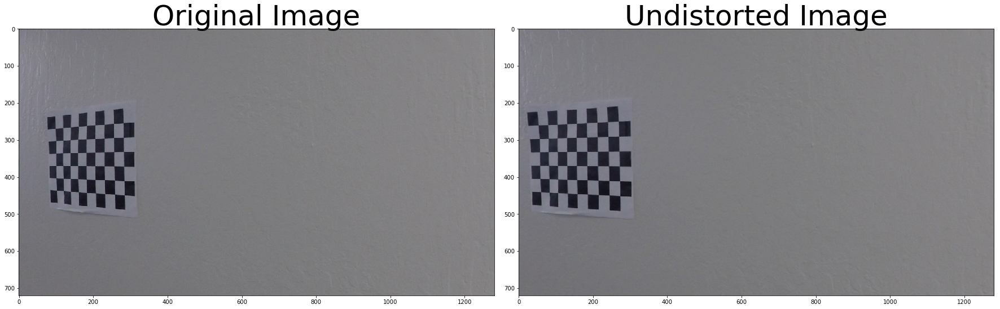

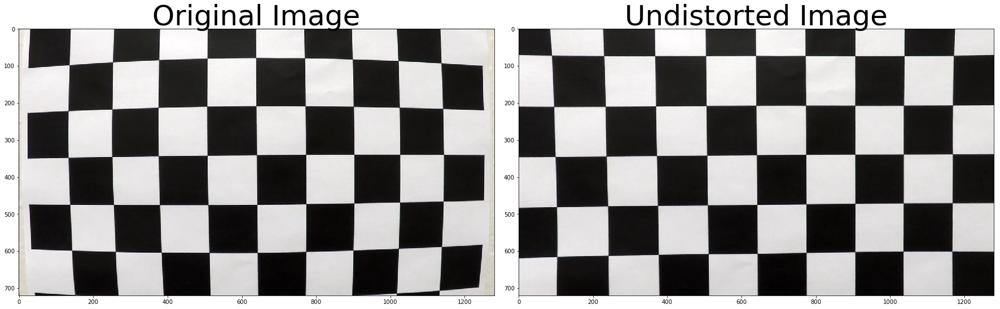

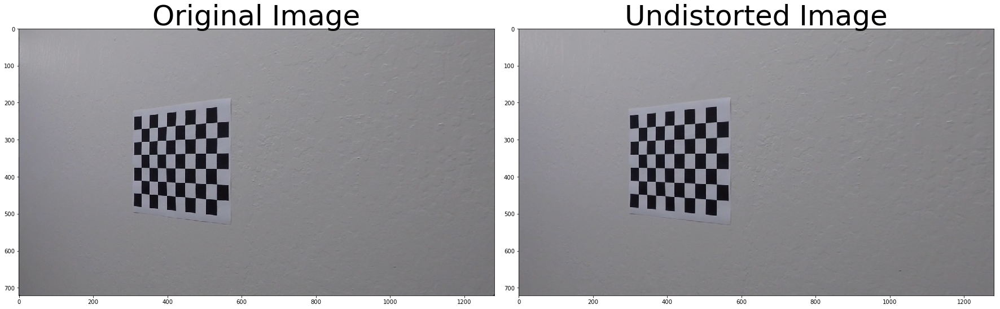

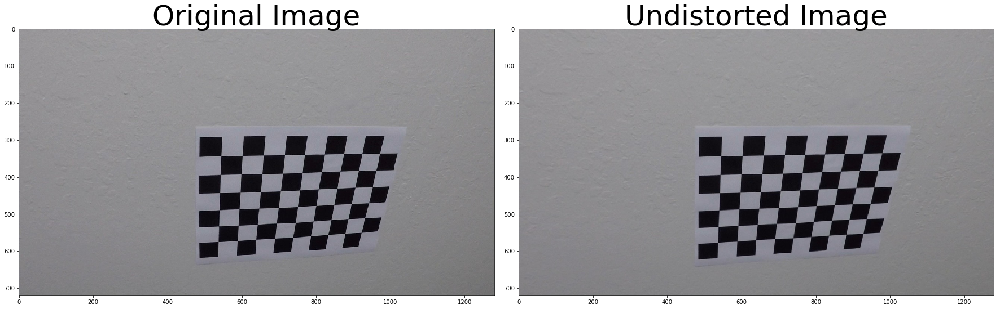

In [46]:
for image_list in path:    
    distorted_image = mpimg.imread('./camera_cal/' + image_list)
    undistorted_image = cal_undistort(distorted_image, object_point, image_point, mtx, dist)

    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
    f.tight_layout()
    ax1.imshow(distorted_image)
    ax1.set_title('Original Image', fontsize=50)
    ax2.imshow(undistorted_image)
    ax2.set_title('Undistorted Image', fontsize=50)
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)
    
#     cv2.imwrite('./camera_cal_output/' + image_list, undistorted_image)
#     plt.savefig('./camera_cal_output/' + image_list)

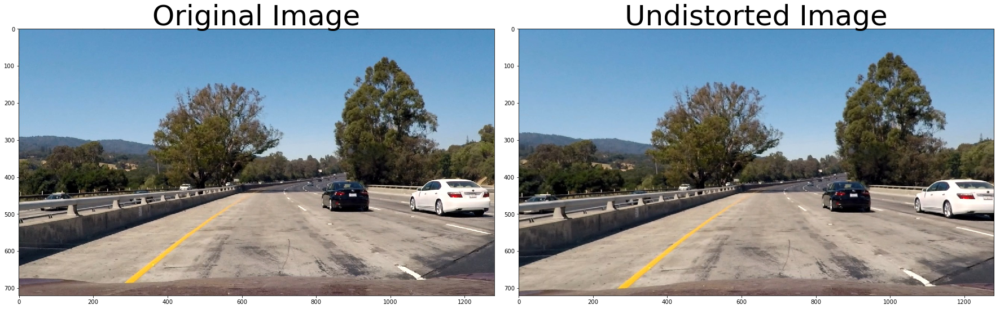

In [53]:
test_distorted_image = mpimg.imread('./test_images/test1.jpg')
test_undistorted_image = cal_undistort(test_distorted_image, object_point, image_point, mtx, dist)

f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
f.tight_layout()
ax1.imshow(test_distorted_image)
ax1.set_title('Original Image', fontsize=50)
ax2.imshow(test_undistorted_image)
ax2.set_title('Undistorted Image', fontsize=50)
plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

plt.savefig('./Undistorted_images/test1.jpg')

In [66]:
import math
def grayscale(img):
    return cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)

def hlsscale(img):
    return cv2.cvtColor(img, cv2.COLOR_RGB2HLS)

def canny(img, low_threshold, high_threshold):
    return cv2.Canny(img, low_threshold, high_threshold)

def gaussian_blur(img, kernel_size):
    return cv2.GaussianBlur(img, (kernel_size, kernel_size), 0)

def region_of_interest(img, vertices):
    # defining a blank mask to start with
    mask = np.zeros_like(img)
    
    # defining a 3 channel or 1 channel color to fill the mask with depending on the input image
    if len(img.shape) > 2:
        channel_count = img.shape[2]
        ignore_mask_color = (255, ) * channel_count
    else:
        ignore_mask_color = 255
        
    # filling pixels inside the polygon defined by "vertices" with the fill color
    cv2.fillPoly(mask, vertices, ignore_mask_color)
    
    # returning the image only where mask pixels are nonzero
    masked_image = cv2.bitwise_and(img, mask)
    return masked_image


def weighted_img(img, initial_img, alpha=0.8, beta=1., gamma=0.):
    return cv2.addWeighted(initial_img, alpha, img, beta, gamma)


In [67]:
# * Compute the camera calibration matrix and distortion coefficients given a set of chessboard images.
# * Apply a distortion correction to raw images.
# * Use color transforms, gradients, etc., to create a thresholded binary image.
# * Apply a perspective transform to rectify binary image ("birds-eye view").
# * Detect lane pixels and fit to find the lane boundary. 
# * Determine the curvature of the lane and vehicle position with respect to center.
# * Warp the detected lane boundaries back onto the original image.
# * Output visual display of the lane boundaries and numerical estimation of lane curvature and vehicle position.

class AdvancedLaneFinder:
    def __init__(self, src):        
        height, width, channels = src.shape
        
        src = cal_undistort(src, object_point, image_point, mtx, dist)
        
        # image gray channel
        gray = grayscale(src)
        
        # test various color channel
        # s_channel from hls color space
        hls = hlsscale(src)
        s_channel = hls[:,:,2]
        
        # Threshold for Canny Edge
        low_threshold = 70
        high_threshold = 210
        
        # Threshold for Sobel Edge
        thresh_min = 20
        thresh_max = 100
        
        # Sobel X
        sobelx = cv2.Sobel(gray, cv2.CV_64F, 1, 0) # Take the derivative in x
        abs_sobelx = np.absolute(sobelx) # Absolute x derivative to accentuate lines
        scaled_sobelX = np.uint8(255*abs_sobelx/np.max(abs_sobelx))
        
        sobel_mask = np.zeros_like(scaled_sobelX)
        sobel_mask[(scaled_sobelX >= thresh_min) & (scaled_sobelX <= thresh_max)] = 1
        binary_output = np.copy(sobel_mask)       
        
        # Binary
        sxbinary = np.zeros_like(scaled_sobelX)
        sxbinary[(scaled_sobelX >= thresh_min) & (scaled_sobelX <= thresh_max)] = 1
        
        # Threshold color channel
        s_thresh_min = 170
        s_thresh_max = 255
        s_binary = np.zeros_like(s_channel)
        s_binary[(s_channel >= s_thresh_min) & (s_channel <= s_thresh_max)] = 1
        
        color_binary = np.dstack((np.zeros_like(sxbinary), sxbinary, s_binary)) * 255
        
        # Combine the two binary thresholds
        combined_binary = np.zeros_like(sxbinary)
        combined_binary[(s_binary == 1) | (sxbinary == 1)] = 1
        
        # Set ROI
        start = (50, height)
        middle1 = (width / 2 - 45, height / 2 + 60)
        middle2 = (width / 2 + 45, height / 2 + 60)
        end = (width - 50, height)

        pts = np.array([start, middle1, middle2, end], np.int32)
        masked_img = region_of_interest(combined_binary, [pts])
                
        
        # Set Points for Top-view
        # Left Up
        cv2.circle(src, (600, (int)(height*11/18)), 2, (255, 0, 0), 20)
        # Right Up
        cv2.circle(src, (700, (int)(height*11/18)), 2, (255, 0, 0), 20)
        # Left Down
        cv2.circle(src, (200, height), 2, (255, 0, 0), 20)
        # Right Down
        cv2.circle(src, (1200, height), 2, (255, 0, 0), 20)
        
        # Draw lines
        cv2.line(src, (600, (int)(height*11/18)), (200, height), (255, 0, 0), 5)
        cv2.line(src, (700, (int)(height*11/18)), (1200, height), (255, 0, 0), 5)
              
        # Src Point before perspective transform
        srcPoint = np.float32(
            [[600, (int)(height*11/18)],
            [700, (int)(height*11/18)],
            [200, height],
            [1200, height]]
        )
        
        dstPoint = np.float32(
        [[300, 0],
        [950, 0],
        [300, height],
        [950, height]]
        )
        
        # Get Image size
        image_size = (width, height)
        
        # Get Transform matrix
        M = cv2.getPerspectiveTransform(srcPoint, dstPoint)
        
        # Warp image
        warped = cv2.warpPerspective(masked_img, M, image_size, flags=cv2.INTER_LINEAR)
        
        # Get Histogram
        histogram = np.sum(warped[warped.shape[0]//2:,:], axis=0)
        
        # Create an output image to draw on and visualize the result
        out_img = np.dstack((warped, warped, warped))
        
        # These will be the starting point for the left and right lines
        midpoint = np.int(histogram.shape[0]//2)
        leftx_base = np.argmax(histogram[:midpoint])
        rightx_base = np.argmax(histogram[midpoint:]) + midpoint
        
        # Hyperparameters
        nwindows = 9
        margin = 100
        minpix = 50
        
        # Set height of windows - based on nwindows above and image shape
        window_height = np.int(warped.shape[0]//nwindows)
        
        # Identify the x and y positions of all nonzero pixels in the image
        nonzero = warped.nonzero()
        nonzeroy = np.array(nonzero[0])
        nonzerox = np.array(nonzero[1])
        
        # Current positions to be updated later for each window in nwindows
        leftx_current = leftx_base
        rightx_current = rightx_base
        
        # Create empty lists to receive left and right lane pixel indices
        left_lane_inds = []
        right_lane_inds = []
        
        # Step through the windows one by one
        for window in range(nwindows):
            win_y_low = warped.shape[0] - window_height * (1 + window)
            win_y_high = warped.shape[0] - window_height * window
            
            win_xleft_low = leftx_current - margin
            win_xleft_high = leftx_current + margin
            win_xright_low = rightx_current - margin
            win_xright_high = rightx_current + margin
            
            # Draw the sliding windows on out_img
            cv2.rectangle(out_img, (win_xleft_low, win_y_low), (win_xleft_high, win_y_high), (255, 255, 255), 2)
            cv2.rectangle(out_img, (win_xright_low, win_y_low), (win_xright_high, win_y_high), (255, 255, 255), 2)
            
            # Identify the nonzero pixels in x and within the window
            good_left_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) &
                             (nonzerox >= win_xleft_low) & (nonzerox < win_xleft_high)).nonzero()[0]
            good_right_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) &
                              (nonzerox >= win_xright_low) & (nonzerox < win_xright_high)).nonzero()[0]
            
            # Append these indices to the lists
            left_lane_inds.append(good_left_inds)
            right_lane_inds.append(good_right_inds)
            
            # If you found > minpix pixels, recenter next window on their mean position
            if len(good_left_inds) > minpix:
                leftx_current = np.int(np.mean(nonzerox[good_left_inds]))
            if len(good_right_inds) > minpix:
                rightx_current = np.int(np.mean(nonzerox[good_right_inds]))
        
        # Concatenate the arrays of indices (previously was a list of lists of pixels)
        try:
            left_lane_inds = np.concatenate(left_lane_inds)
            right_lane_inds = np.concatenate(right_lane_inds)
        except ValueError:
            # Avoids an error if the above is not implemented fully
            pass
        
        # Extract left and right line pixel positions
        leftx = nonzerox[left_lane_inds]
        lefty = nonzeroy[left_lane_inds]
        rightx = nonzerox[right_lane_inds]
        righty = nonzeroy[right_lane_inds]
        
        print('leftx : ', leftx)
        print('lefty : ', lefty)
        print('rightx : ', rightx)
        print('righty : ', righty)
        print('left_lane_inds : ', left_lane_inds)
        print('right_lane_inds : ')
        print('leftx[0] : ', leftx[0])
        print('lefty[0] : ', lefty[0])
        
        # Let's implement RANSAC algorithm
        random_num = []
        for extract_three_random_number in range(3):
            random_index = random.randrange(0, len(leftx))
            random_num.append(random_index)
            
        print(random_num)
        
        RANSAC_MATRIX_INPUT = [[leftx[random_num[0]]**2, leftx[random_num[0]], 1],
                           [leftx[random_num[1]]**2, leftx[random_num[1]], 1],
                           [leftx[random_num[2]]**2, leftx[random_num[2]], 1]]
        RANSAC_MATRIX_OUTPUT = [[lefty[random_num[0]]], 
                                lefty[random_num[1]],
                                lefty[random_num[2]]]
        
        # Fit a second order polynomial to each using 'np.polyfit'
        left_fit = np.polyfit(lefty, leftx, 2)
        right_fit = np.polyfit(righty, rightx, 2)
        
        # Generate x and y values for plotting
        ploty = np.linspace(0, warped.shape[0] - 1, warped.shape[0])
        try:
            left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
            right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]
        except TypeError:
            # Avoids an error if 'left' and 'right_fit' are still none or incorrect
            print('The function failed to fit a line')
            left_fitx = 1*ploty**2 + 1*ploty
            right_fitx = 1*ploty**2 + 1*ploty
            
        ## Visualization ##
        # Colors in the left and right lane regions
#         out_img[lefty, leftx] = [255, 0, 0]
#         out_img[righty, rightx] = [0, 0, 255]
        out_img[lefty, leftx] = [255, 0, 0]
        out_img[righty, rightx] = [0, 0, 255]
        
        int_left_fitx = [int(x) for x in left_fitx]
        int_right_fitx = [int(x) for x in right_fitx]
#         print('left_fitx : ', int_left_fitx)
#         print('right_fitx : ', int_right_fitx)
#         print('ploty : ', ploty)
    
#         XX, YY = np.meshgrid(np.arange(0, src.shape[1]), np.arange(0, src.shape[0]))
#         region_lane_line = (YY > (XX * left_fit[0]**2 + XX * left_fit[1] + left_fit[2])) & (YY < (XX * right_fit[0]**2 + XX * right_fit[1] + right_fit[2]))
        
#         masked_img[region_lane_line] = [0, 255, 0]
#         plt.imshow(masked_img)
#         plt.show()
        
        # Plots the left and right polynomials on the lane lines
        plt.plot(left_fitx, ploty, color='yellow')
        plt.plot(right_fitx, ploty, color='yellow')
        
        # Get Inverse Transform matrix
        Minv = cv2.getPerspectiveTransform(dstPoint, srcPoint)
        
        # Get Inverse Warp image
        inv_warped = cv2.warpPerspective(masked_img, Minv, image_size, flags=cv2.INTER_LINEAR)
        
#         plt.subplot(2, 2, 1)
        plt.imshow(out_img)
        plt.savefig('./out_img')
#         plt.show()
#         plt.subplot(1, 2, 1)
#         plt.subplot(2, 2, 2)
        plt.imshow(src)
        plt.savefig('./src')
#         plt.show()
#         plt.subplot(2, 2, 3)
        plt.imshow(combined_binary, cmap='gray')
        plt.savefig('./combined_binary')
#         plt.show()
        
#         plt.subplot(2, 2, 4)
        plt.imshow(warped, cmap='gray')
        plt.savefig('./warped')
        plt.show()        
        
#         plt.imshow(inv_warped)
#         plt.show()
        

In [68]:
images = os.listdir('/home/seunghwan/Udacity/Project#2/CarND-Advanced-Lane-Lines-master/test_images')

test2.jpg
leftx :  [350 354 355 ... 194 195 196]
lefty :  [640 640 640 ...  79  79  79]
rightx :  [877 878 879 ... 602 603 604]
righty :  [640 640 640 ...  79  79  79]
left_lane_inds :  [37938 37939 37940 ...  8332  8333  8334]
right_lane_inds : 
leftx[0] :  350
lefty[0] :  640
[6303, 13092, 15149]


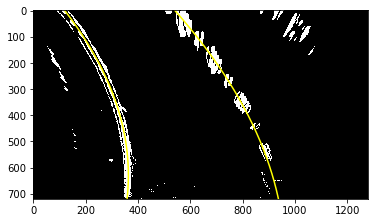

test1.jpg
leftx :  [321 322 323 ... 339 340 341]
lefty :  [640 640 640 ...  79  79  79]
rightx :  [ 819  821  822 ... 1016 1017 1018]
righty :  [643 644 644 ...  79  79  79]
left_lane_inds :  [27934 27935 27936 ...  3764  3765  3766]
right_lane_inds : 
leftx[0] :  321
lefty[0] :  640
[10148, 5484, 189]


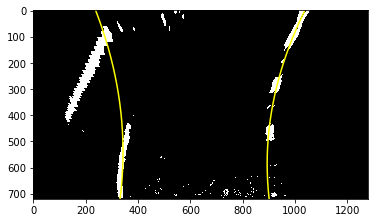

test4.jpg
leftx :  [335 336 337 ... 327 328 329]
lefty :  [640 640 640 ...  79  79  79]
rightx :  [ 943  945  946 ... 1016  996 1014]
righty :  [684 684 684 ...  57  58  58]
left_lane_inds :  [33780 33781 33782 ...  6164  6165  6166]
right_lane_inds : 
leftx[0] :  335
lefty[0] :  640
[10628, 7134, 2639]


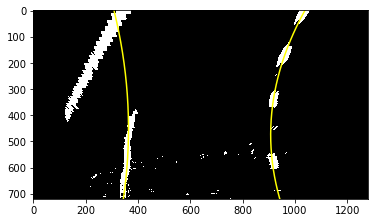

test6.jpg
leftx :  [342 343 344 ... 450 451 452]
lefty :  [640 640 640 ...  79  79  79]
rightx :  [ 920  924  925 ... 1032 1033 1034]
righty :  [656 656 656 ...  79  79  79]
left_lane_inds :  [40175 40176 40177 ...  7515  7516  7517]
right_lane_inds : 
leftx[0] :  342
lefty[0] :  640
[15871, 15269, 7002]


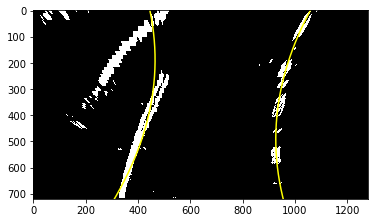

test5.jpg
leftx :  [281 282 283 ... 567 568 569]
lefty :  [640 640 640 ...  79  79  79]
rightx :  [ 892  893  894 ... 1032 1033 1034]
righty :  [640 640 640 ...  79  79  79]
left_lane_inds :  [38332 38333 38334 ...  4852  4853  4854]
right_lane_inds : 
leftx[0] :  281
lefty[0] :  640
[7131, 4162, 7072]


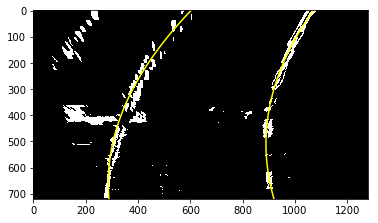

straight_lines1.jpg
leftx :  [300 301 302 ... 397 398 399]
lefty :  [640 640 640 ...  79  79  79]
rightx :  [868 866 864 ... 774 775 776]
righty :  [649 650 651 ...  79  79  79]
left_lane_inds :  [51344 51345 51346 ... 13836 13837 13838]
right_lane_inds : 
leftx[0] :  300
lefty[0] :  640
[6054, 28210, 12818]


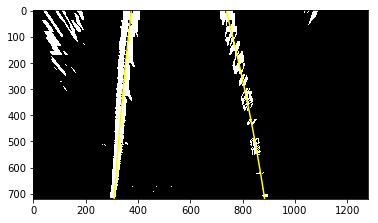

straight_lines2.jpg
leftx :  [306 307 308 ... 374 375 376]
lefty :  [641 641 641 ...  79  79  79]
rightx :  [863 864 865 ... 811 812 813]
righty :  [640 640 640 ...  79  79  79]
left_lane_inds :  [34808 34809 34810 ...  6264  6265  6266]
right_lane_inds : 
leftx[0] :  306
lefty[0] :  641
[2276, 2321, 11551]


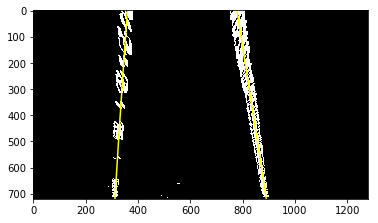

test3.jpg
leftx :  [326 327 328 ... 684 685 686]
lefty :  [640 640 640 ...  79  79  79]
rightx :  [ 894  898  899 ... 1038 1039 1040]
righty :  [640 640 640 ...  79  79  79]
left_lane_inds :  [38254 38255 38256 ...  4187  4188  4189]
right_lane_inds : 
leftx[0] :  326
lefty[0] :  640
[18612, 11712, 1350]


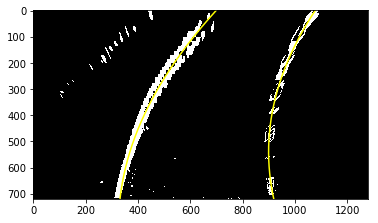

In [69]:
path = '/home/seunghwan/Udacity/Project#2/CarND-Advanced-Lane-Lines-master/test_images/'
for image in images:
    print(image)
    src = mpimg.imread(path + image)
    AdvancedLaneFinder(src)

In [70]:
# from moviepy.editor import VideoFileClip
# from IPython.display import HTML

In [8]:
video_path = '/home/seunghwan/Udacity/Project#2/CarND-Advanced-Lane-Lines-master/'

In [9]:
project_output = 'project_video.mp4'

In [10]:
challenge_output = 'challenge_video.mp4'

In [11]:
harder_output = 'harder_challenge_video.mp4'

leftx :  [342 343 344 ... 200 201 202]
lefty :  [640 640 640 ...  79  79  79]
rightx :  [914 915 918 ... 641 642 643]
righty :  [640 640 640 ...  79  79  79]
left_lane_inds :  [37381 37382 37383 ...  8581  8582  8583]
right_lane_inds : 
leftx[0] :  342
lefty[0] :  640
[15625, 11632, 792]


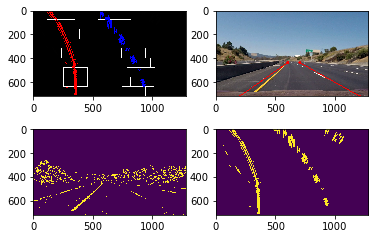

leftx :  [345 348 349 ... 194 195 196]
lefty :  [640 640 640 ...  79  79  79]
rightx :  [912 913 914 ... 636 637 638]
righty :  [640 640 640 ...  79  79  79]
left_lane_inds :  [36448 36449 36450 ...  7495  7496  7497]
right_lane_inds : 
leftx[0] :  345
lefty[0] :  640
[7391, 1804, 2121]


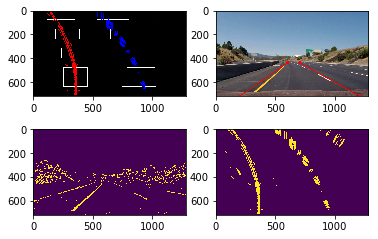

leftx :  [346 347 348 ... 194 195 196]
lefty :  [640 640 640 ...  79  79  79]
rightx :  [911 912 913 ... 599 600 601]
righty :  [640 640 640 ...  79  79  79]
left_lane_inds :  [38343 38344 38345 ...  8772  8773  8774]
right_lane_inds : 
leftx[0] :  346
lefty[0] :  640
[1093, 4119, 15756]


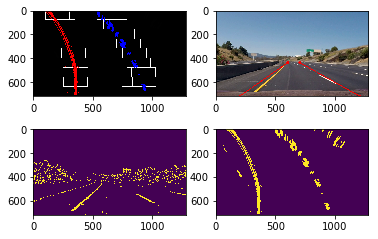

leftx :  [347 348 349 ... 194 195 196]
lefty :  [640 640 640 ...  79  79  79]
rightx :  [910 911 912 ... 606 607 608]
righty :  [640 640 640 ...  79  79  79]
left_lane_inds :  [38923 38924 38925 ...  9641  9642  9643]
right_lane_inds : 
leftx[0] :  347
lefty[0] :  640
[1799, 12519, 8984]


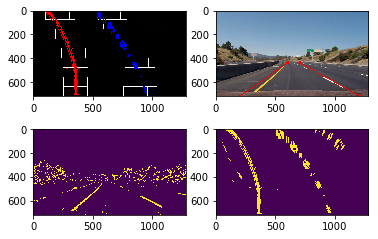

leftx :  [348 349 350 ... 190 191 192]
lefty :  [640 640 640 ...  79  79  79]
rightx :  [933 934 935 ... 612 613 614]
righty :  [641 641 641 ...  79  79  79]
left_lane_inds :  [37992 37993 37994 ...  9869  9870  9871]
right_lane_inds : 
leftx[0] :  348
lefty[0] :  640
[4873, 7930, 14990]


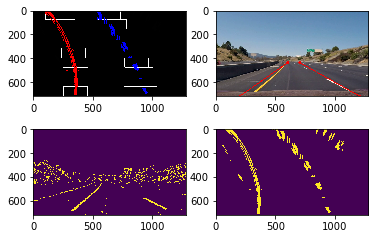

leftx :  [350 351 352 ... 188 189 190]
lefty :  [640 640 640 ...  79  79  79]
rightx :  [941 942 944 ... 581 582 583]
righty :  [658 658 658 ...  79  79  79]
left_lane_inds :  [37976 37977 37978 ...  8417  8418  8419]
right_lane_inds : 
leftx[0] :  350
lefty[0] :  640
[4857, 9895, 10988]


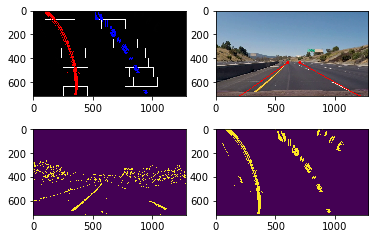

leftx :  [348 349 350 ... 188 189 190]
lefty :  [640 640 640 ...  79  79  79]
rightx :  [937 934 931 ... 587 588 589]
righty :  [657 665 666 ...  79  79  79]
left_lane_inds :  [39016 39017 39018 ...  9522  9523  9524]
right_lane_inds : 
leftx[0] :  348
lefty[0] :  640
[11437, 9222, 15672]


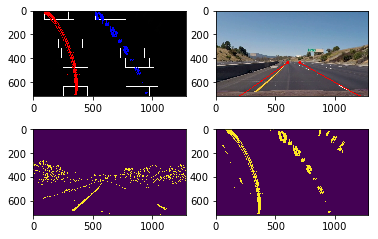

leftx :  [350 351 352 ... 183 184 185]
lefty :  [640 640 640 ...  79  79  79]
rightx :  [923 924 940 ... 593 594 595]
righty :  [646 646 674 ...  79  79  79]
left_lane_inds :  [39966 39967 39968 ...  9343  9344  9345]
right_lane_inds : 
leftx[0] :  350
lefty[0] :  640
[12522, 8040, 18676]


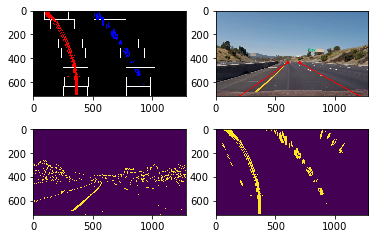

leftx :  [350 351 352 ... 184 185 186]
lefty :  [640 640 640 ...  79  79  79]
rightx :  [914 915 916 ... 600 601 602]
righty :  [640 640 640 ...  79  79  79]
left_lane_inds :  [38701 38702 38703 ...  7762  7763  7764]
right_lane_inds : 
leftx[0] :  350
lefty[0] :  640
[16429, 8221, 4015]


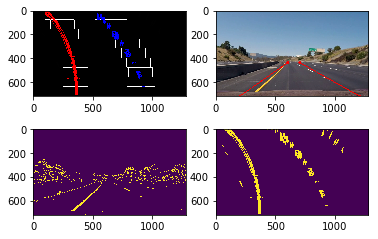

leftx :  [350 351 352 ... 179 180 181]
lefty :  [640 640 640 ...  79  79  79]
rightx :  [935 936 937 ... 600 601 602]
righty :  [655 655 655 ...  79  79  79]
left_lane_inds :  [38548 38549 38550 ...  8525  8526  8527]
right_lane_inds : 
leftx[0] :  350
lefty[0] :  640
[16387, 7729, 1411]


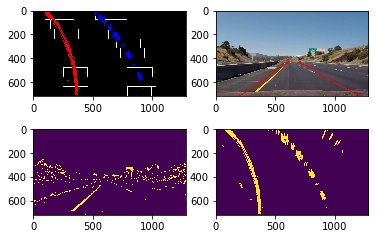

leftx :  [350 351 352 ... 177 178 179]
lefty :  [640 640 640 ...  79  79  79]
rightx :  [940 941 942 ... 589 590 591]
righty :  [674 674 674 ...  79  79  79]
left_lane_inds :  [38928 38929 38930 ...  7149  7150  7151]
right_lane_inds : 
leftx[0] :  350
lefty[0] :  640
[13916, 33, 18536]


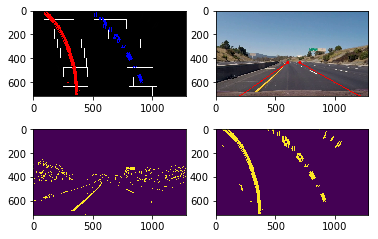

leftx :  [346 347 348 ... 179 180 181]
lefty :  [640 640 640 ...  79  79  79]
rightx :  [939 933 934 ... 618 619 620]
righty :  [676 677 677 ...  79  79  79]
left_lane_inds :  [40166 40167 40168 ...  9210  9211  9212]
right_lane_inds : 
leftx[0] :  346
lefty[0] :  640
[2057, 2992, 10597]


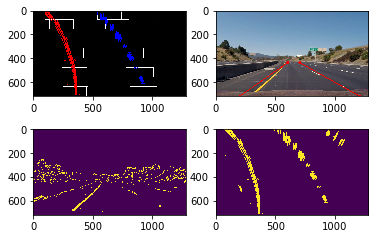

leftx :  [285 286 287 ... 173 174 175]
lefty :  [640 640 640 ...  79  79  79]
rightx :  [793 795 857 ... 606 607 608]
righty :  [695 695 699 ...  79  79  79]
left_lane_inds :  [38414 38415 38416 ...  7365  7366  7367]
right_lane_inds : 
leftx[0] :  285
lefty[0] :  640
[10484, 17022, 10814]


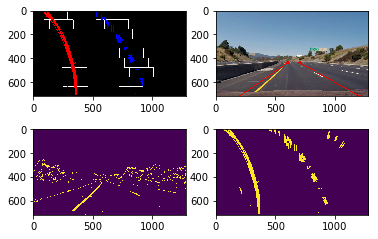

leftx :  [346 347 351 ... 173 174 175]
lefty :  [640 640 640 ...  79  79  79]
rightx :  [912 913 914 ... 612 613 614]
righty :  [640 640 640 ...  79  79  79]
left_lane_inds :  [39090 39091 39092 ...  9809  9810  9811]
right_lane_inds : 
leftx[0] :  346
lefty[0] :  640
[5732, 7875, 789]


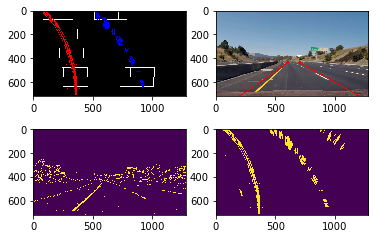

leftx :  [351 352 353 ... 165 166 167]
lefty :  [640 640 640 ...  79  79  79]
rightx :  [910 911 914 ... 559 560 561]
righty :  [640 640 640 ...  79  79  79]
left_lane_inds :  [40325 40326 40327 ... 10139 10140 10141]
right_lane_inds : 
leftx[0] :  351
lefty[0] :  640
[3839, 2455, 18114]


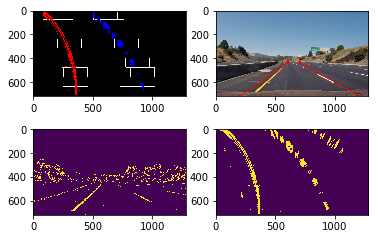

leftx :  [351 352 353 ... 161 162 163]
lefty :  [640 640 640 ...  79  79  79]
rightx :  [906 907 911 ... 528 529 530]
righty :  [640 640 640 ...  79  79  79]
left_lane_inds :  [41759 41760 41761 ... 10571 10572 10573]
right_lane_inds : 
leftx[0] :  351
lefty[0] :  640
[13638, 1847, 13520]


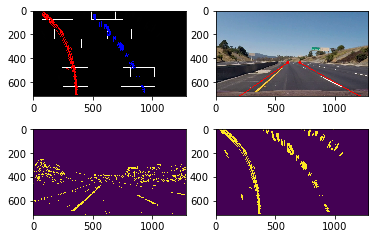

leftx :  [346 347 348 ... 155 156 157]
lefty :  [640 640 640 ...  79  79  79]
rightx :  [908 909 910 ... 534 535 536]
righty :  [644 644 644 ...  79  79  79]
left_lane_inds :  [42420 42421 42422 ... 11085 11086 11087]
right_lane_inds : 
leftx[0] :  346
lefty[0] :  640
[1174, 5984, 6367]


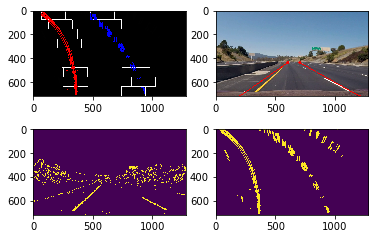

leftx :  [347 348 349 ... 149 150 151]
lefty :  [640 640 640 ...  79  79  79]
rightx :  [916 918 919 ... 540 541 542]
righty :  [661 661 661 ...  79  79  79]
left_lane_inds :  [43247 43248 43249 ... 12004 12005 12006]
right_lane_inds : 
leftx[0] :  347
lefty[0] :  640
[8476, 8746, 11870]


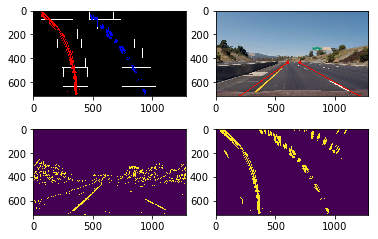

leftx :  [346 347 348 ... 155 156 157]
lefty :  [640 640 640 ...  79  79  79]
rightx :  [937 938 941 ... 548 549 550]
righty :  [671 671 671 ...  79  79  79]
left_lane_inds :  [42369 42370 42371 ... 11449 11450 11451]
right_lane_inds : 
leftx[0] :  346
lefty[0] :  640
[17294, 7193, 94]


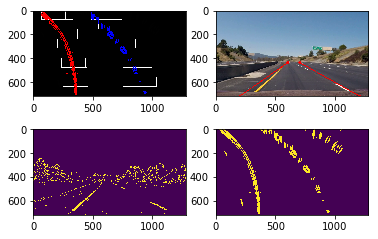

leftx :  [345 346 347 ... 155 156 157]
lefty :  [640 640 640 ...  79  79  79]
rightx :  [926 927 924 ... 558 559 560]
righty :  [661 664 665 ...  79  79  79]
left_lane_inds :  [41431 41432 41433 ... 11437 11438 11439]
right_lane_inds : 
leftx[0] :  345
lefty[0] :  640
[5993, 2265, 9944]


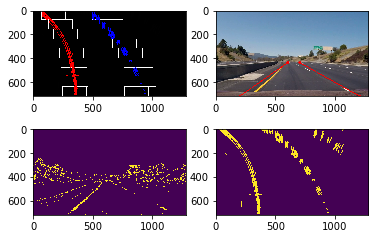

leftx :  [342 343 344 ... 155 156 157]
lefty :  [640 640 640 ...  79  79  79]
rightx :  [926 929 924 ... 569 570 571]
righty :  [659 659 660 ...  79  79  79]
left_lane_inds :  [39999 40000 40001 ... 10724 10725 10726]
right_lane_inds : 
leftx[0] :  342
lefty[0] :  640
[15234, 15374, 2820]


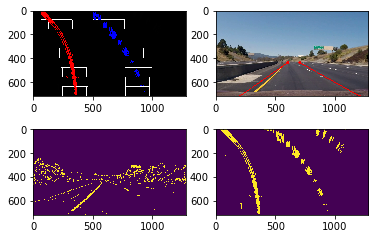

leftx :  [338 339 340 ... 165 166 167]
lefty :  [640 640 640 ...  79  79  79]
rightx :  [916 917 918 ... 577 578 579]
righty :  [645 645 645 ...  79  79  79]
left_lane_inds :  [37509 37510 37511 ...  9271  9272  9273]
right_lane_inds : 
leftx[0] :  338
lefty[0] :  640
[10781, 10322, 7704]


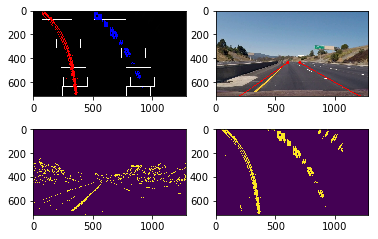

leftx :  [337 338 342 ... 165 166 167]
lefty :  [640 640 640 ...  79  79  79]
rightx :  [927 922 923 ... 587 588 589]
righty :  [661 662 662 ...  79  79  79]
left_lane_inds :  [38457 38458 38459 ... 10832 10833 10834]
right_lane_inds : 
leftx[0] :  337
lefty[0] :  640
[18536, 9851, 6202]


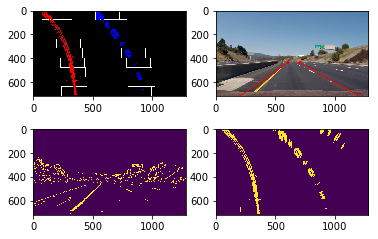

leftx :  [335 336 337 ... 155 156 157]
lefty :  [640 640 640 ...  79  79  79]
rightx :  [726 710 728 ... 593 594 595]
righty :  [704 710 710 ...  79  79  79]
left_lane_inds :  [37683 37684 37685 ...  8231  8232  8233]
right_lane_inds : 
leftx[0] :  335
lefty[0] :  640
[3102, 14937, 2750]


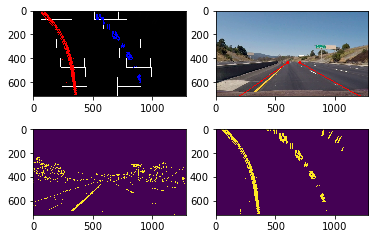

leftx :  [335 336 337 ... 149 150 151]
lefty :  [640 640 640 ...  79  79  79]
rightx :  [877 885 897 ... 589 590 591]
righty :  [705 715 716 ...  79  79  79]
left_lane_inds :  [38532 38533 38534 ...  8056  8057  8058]
right_lane_inds : 
leftx[0] :  335
lefty[0] :  640
[12652, 11283, 439]


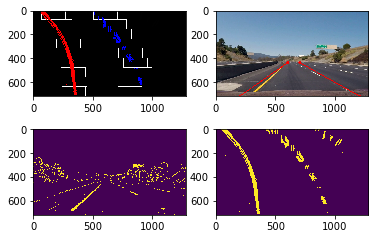

leftx :  [276 277 278 ... 155 156 157]
lefty :  [640 640 640 ...  79  79  79]
rightx :  [905 906 911 ... 612 613 614]
righty :  [640 640 640 ...  79  79  79]
left_lane_inds :  [37814 37815 37816 ...  8869  8870  8871]
right_lane_inds : 
leftx[0] :  276
lefty[0] :  640
[17232, 13178, 9814]


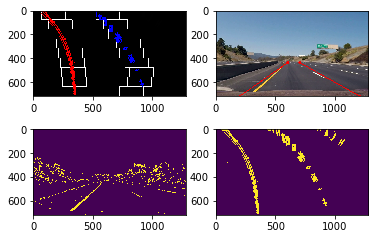

leftx :  [330 331 332 ... 155 156 157]
lefty :  [640 640 640 ...  79  79  79]
rightx :  [907 912 913 ... 606 607 608]
righty :  [640 640 640 ...  79  79  79]
left_lane_inds :  [36496 36497 36498 ...  8071  8072  8073]
right_lane_inds : 
leftx[0] :  330
lefty[0] :  640
[8452, 4052, 17378]


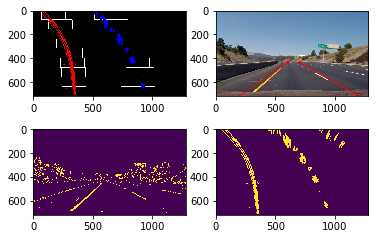

leftx :  [328 329 330 ... 161 162 163]
lefty :  [640 640 640 ...  79  79  79]
rightx :  [910 911 916 ... 624 625 626]
righty :  [640 640 640 ...  79  79  79]
left_lane_inds :  [34269 34270 34271 ...  7315  7316  7317]
right_lane_inds : 
leftx[0] :  328
lefty[0] :  640
[11420, 5939, 2893]


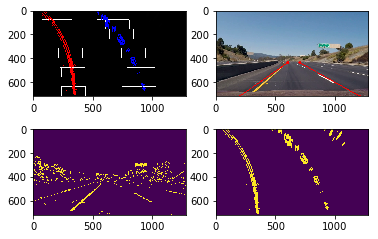

leftx :  [328 329 330 ... 155 156 157]
lefty :  [640 640 640 ...  79  79  79]
rightx :  [908 909 915 ... 606 607 608]
righty :  [640 640 640 ...  79  79  79]
left_lane_inds :  [35632 35633 35634 ...  8161  8162  8163]
right_lane_inds : 
leftx[0] :  328
lefty[0] :  640
[5996, 14168, 11094]


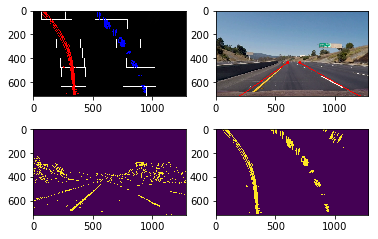

leftx :  [329 330 331 ... 153 154 155]
lefty :  [640 640 640 ...  79  79  79]
rightx :  [915 916 917 ... 575 576 577]
righty :  [646 646 646 ...  79  79  79]
left_lane_inds :  [38220 38221 38222 ... 10364 10365 10366]
right_lane_inds : 
leftx[0] :  329
lefty[0] :  640
[1596, 5439, 3157]


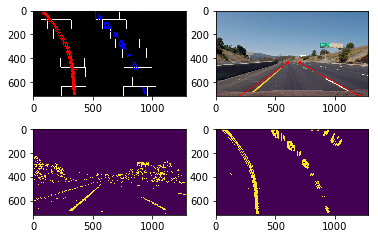

leftx :  [332 333 334 ... 149 150 151]
lefty :  [640 640 640 ...  79  79  79]
rightx :  [923 924 926 ... 563 564 565]
righty :  [660 660 660 ...  79  79  79]
left_lane_inds :  [38312 38313 38314 ...  9340  9341  9342]
right_lane_inds : 
leftx[0] :  332
lefty[0] :  640
[19286, 15718, 12493]


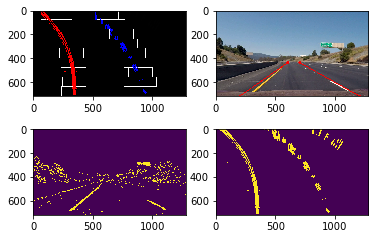

leftx :  [333 334 335 ... 143 144 145]
lefty :  [640 640 640 ...  79  79  79]
rightx :  [922 921 919 ... 542 543 544]
righty :  [665 677 678 ...  79  79  79]
left_lane_inds :  [40355 40356 40357 ... 10026 10027 10028]
right_lane_inds : 
leftx[0] :  333
lefty[0] :  640
[10458, 12439, 18354]


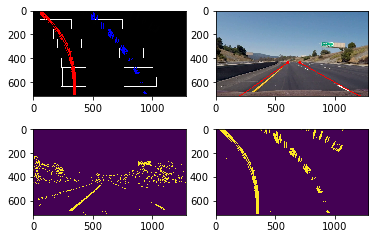

leftx :  [333 334 335 ... 149 150 151]
lefty :  [640 640 640 ...  79  79  79]
rightx :  [921 932 934 ... 553 554 555]
righty :  [667 682 682 ...  79  79  79]
left_lane_inds :  [38598 38599 38600 ...  8702  8703  8704]
right_lane_inds : 
leftx[0] :  333
lefty[0] :  640
[18831, 1119, 1045]


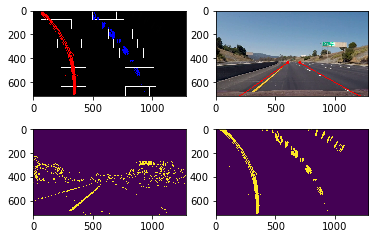

leftx :  [334 335 336 ... 143 144 145]
lefty :  [640 640 640 ...  79  79  79]
rightx :  [909 910 914 ... 559 560 561]
righty :  [640 640 640 ...  79  79  79]
left_lane_inds :  [38428 38429 38430 ...  8462  8463  8464]
right_lane_inds : 
leftx[0] :  334
lefty[0] :  640
[8642, 2539, 14608]


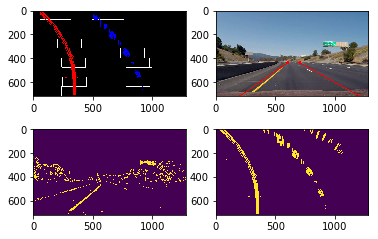

leftx :  [335 336 337 ... 143 144 145]
lefty :  [640 640 640 ...  79  79  79]
rightx :  [921 922 923 ... 546 547 548]
righty :  [653 653 653 ...  79  79  79]
left_lane_inds :  [39311 39312 39313 ...  8615  8616  8617]
right_lane_inds : 
leftx[0] :  335
lefty[0] :  640
[12341, 13148, 12749]


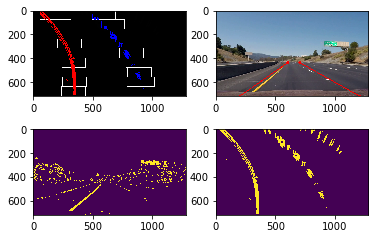

leftx :  [338 339 340 ... 143 144 145]
lefty :  [640 640 640 ...  79  79  79]
rightx :  [741 710 804 ... 511 512 513]
righty :  [708 710 712 ...  79  79  79]
left_lane_inds :  [41022 41023 41024 ...  9888  9889  9890]
right_lane_inds : 
leftx[0] :  338
lefty[0] :  640
[232, 2224, 7325]


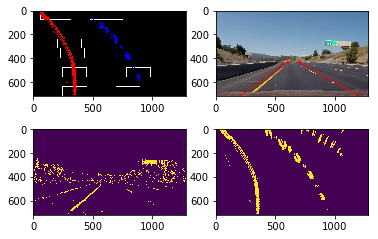

leftx :  [338 339 340 ... 143 144 145]
lefty :  [640 640 640 ...  79  79  79]
rightx :  [785 710 804 ... 522 523 524]
righty :  [706 710 712 ...  79  79  79]
left_lane_inds :  [40241 40242 40243 ...  9204  9205  9206]
right_lane_inds : 
leftx[0] :  338
lefty[0] :  640
[9080, 17463, 1816]


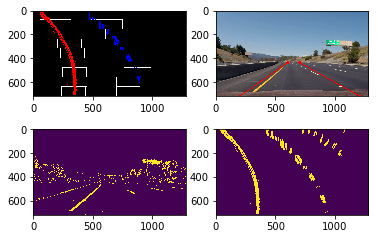

leftx :  [283 284 285 ... 142 143 144]
lefty :  [640 640 640 ...  79  79  79]
rightx :  [899 902 710 ... 487 488 489]
righty :  [672 672 710 ...  79  79  79]
left_lane_inds :  [41203 41204 41205 ...  9821  9822  9823]
right_lane_inds : 
leftx[0] :  283
lefty[0] :  640
[12881, 2210, 12787]


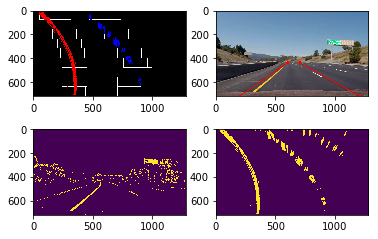

leftx :  [341 342 343 ... 132 133 134]
lefty :  [640 640 640 ...  79  79  79]
rightx :  [901 902 906 ... 495 496 497]
righty :  [640 640 640 ...  79  79  79]
left_lane_inds :  [40992 40993 40994 ...  9042  9043  9044]
right_lane_inds : 
leftx[0] :  341
lefty[0] :  640
[19145, 5449, 8798]


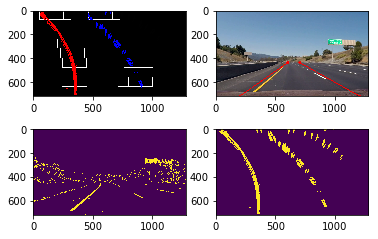

leftx :  [341 342 343 ... 132 133 134]
lefty :  [640 640 640 ...  79  79  79]
rightx :  [901 902 905 ... 505 506 507]
righty :  [640 640 640 ...  79  79  79]
left_lane_inds :  [40954 40955 40956 ...  9457  9458  9459]
right_lane_inds : 
leftx[0] :  341
lefty[0] :  640
[20237, 5164, 20616]


KeyboardInterrupt: 

In [12]:
capture = cv2.VideoCapture(video_path + project_output)

while True:
    if(capture.get(cv2.CAP_PROP_POS_FRAMES) == capture.get(cv2.CAP_PROP_FRAME_COUNT)):
        capture.open(project_output)
    ret, frame = capture.read()

    new_frame = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)
    
    AdvancedLaneFinder(new_frame)
capture.release()
cv2.destroyAllWindows()